In [79]:
import os
import pandas as pd
from app.DataSpliter import GranularDataSplitter
from app.transformers.smoother import Smoother
from app.DataLoader import DataLoader
from app.visualization_utils import draw_plotly
import numpy as np
import matplotlib.pyplot as plt
from typing import Literal
from app.utils import unwrap_angles
from copy import deepcopy
from app.utils import unwrap_angles
from app.visualization_utils import draw_plotly_new

from app.workflow.utils import calculate_overall_score, add_predicted_transitions_to_df, align_min_max_lists_counts_order, get_score_for_intervals, process_turns_with_restricted_distances, read_files, split_data_granular, find_midpoints, find_midpoints_with_weights, label_apex_list, smooth_data, remove_outliers, merge_close_integers, append_predictions_df, find_closest_actuals, extract_turns_and_predictions, find_tp_fp_fn_tn, calculate_performance_metrics, append_predictions_df_new
from app.utils import unwrap_angles, calculate_euler_angles_list
from app.workflow.gradientdescent import gradient_descent_full, gradient_descent, get_curve_points, get_apex_points
from app.workflow.plots import plot_positions, plot_filter_and_extract_points
from itertools import product
from sklearn.model_selection import train_test_split
from tqdm import tqdm
import warnings
import ray
from tqdm import tqdm
import warnings
import numpy as np
import pandas as pd
import warnings
from pandas.errors import SettingWithCopyWarning

warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.simplefilter(action='ignore', category=SettingWithCopyWarning)
%load_ext autoreload
%autoreload 2


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [2]:
labeled_data = read_files(path = "/Users/kuba/SkiApp/data/boris_data_euler/huawei_mate/2024-02-25")

/Users/kuba/SkiApp/data/boris_data_euler/huawei_mate/2024-02-25/6.csv
/Users/kuba/SkiApp/data/boris_data_euler/huawei_mate/2024-02-25/7.csv
/Users/kuba/SkiApp/data/boris_data_euler/huawei_mate/2024-02-25/5.csv
/Users/kuba/SkiApp/data/boris_data_euler/huawei_mate/2024-02-25/4.csv
/Users/kuba/SkiApp/data/boris_data_euler/huawei_mate/2024-02-25/21_sp.csv
/Users/kuba/SkiApp/data/boris_data_euler/huawei_mate/2024-02-25/1.csv
/Users/kuba/SkiApp/data/boris_data_euler/huawei_mate/2024-02-25/3.csv
/Users/kuba/SkiApp/data/boris_data_euler/huawei_mate/2024-02-25/2.csv
/Users/kuba/SkiApp/data/boris_data_euler/huawei_mate/2024-02-25/23.csv
/Users/kuba/SkiApp/data/boris_data_euler/huawei_mate/2024-02-25/22.csv
/Users/kuba/SkiApp/data/boris_data_euler/huawei_mate/2024-02-25/20.csv
/Users/kuba/SkiApp/data/boris_data_euler/huawei_mate/2024-02-25/25.csv
/Users/kuba/SkiApp/data/boris_data_euler/huawei_mate/2024-02-25/19.csv
/Users/kuba/SkiApp/data/boris_data_euler/huawei_mate/2024-02-25/18.csv
/Users/kub

In [3]:
split_on = "Orientation"
orientation_dfs = split_data_granular(labeled_data, split_on=split_on)
transformed_dfs = calculate_euler_angles_list(orientation_dfs)
unwraped_data = unwrap_angles(transformed_dfs)
smoothed_orientation_dfs = smooth_data(unwraped_data, window_size=10)

In [4]:
def label_apex(df: pd.DataFrame) -> pd.DataFrame:
    """Mark apex (most important point in the turn) based on behavior and status column."""
    df_cp = df.copy()

    # Tworzymy nową kolumnę 'Apex' wypełnioną NaN-ami
    df_cp['Apex'] = np.nan

    # Znajdujemy indeksy START i STOP
    start_mask = df_cp['Status'] == 'START'
    stop_mask = df_cp['Status'] == 'STOP'

    # Filtrujemy wiersze dla START i STOP
    starts = df_cp[start_mask].copy()
    stops = df_cp[stop_mask].copy()

    # Dopasowanie indeksów START do najbliższych STOP za pomocą searchsorted
    starts['next_stop_time'] = stops.index[stops.index.searchsorted(starts.index)]

    # Zachowaj tylko te wiersze, gdzie zachowanie (Behavior) jest takie samo
    valid_pairs = starts[starts['Behavior'] == df_cp.loc[starts['next_stop_time'], 'Behavior'].values]

    # Obliczamy środkowy czas pomiędzy START i STOP
    mid_times = valid_pairs.index + (valid_pairs['next_stop_time'] - valid_pairs.index) / 2

    # Znajdujemy indeksy najbliższe do obliczonych środkowych czasów
    nearest_apex_indices = df_cp.index.searchsorted(mid_times)

    # Wypełniamy kolumnę "Apex" na podstawie najbliższych indeksów i zachowań (left/right)
    df_cp.loc[df_cp.index[nearest_apex_indices], 'Apex'] = valid_pairs['Behavior'].values

    return df_cp


In [7]:
orientation_dfs

[                               qz        qy        qx        qw      roll  \
 time                                                                        
 2024-02-25 13:21:02.900  0.781156  0.537564 -0.306568  0.082667  1.179785   
 2024-02-25 13:21:03.000  0.780643  0.531047 -0.322517  0.067586  1.193570   
 2024-02-25 13:21:03.100  0.776171  0.523896 -0.346354  0.055941  1.230469   
 2024-02-25 13:21:03.200  0.771685  0.521936 -0.360059  0.049401  1.258775   
 2024-02-25 13:21:03.300  0.768469  0.516281 -0.375271  0.045593  1.282140   
 ...                           ...       ...       ...       ...       ...   
 2024-02-25 13:22:22.500 -0.338199  0.056737  0.553255  0.759150  0.878959   
 2024-02-25 13:22:22.600 -0.322824  0.061132  0.567243  0.755170  0.920257   
 2024-02-25 13:22:22.700 -0.289544  0.084322  0.567570  0.766105  0.929950   
 2024-02-25 13:22:22.800 -0.249240  0.112278  0.564132  0.779119  0.932684   
 2024-02-25 13:22:22.900 -0.220655  0.128594  0.571005  0.780209

In [8]:
labeled_data = read_files(path = "data/labeled/HUAWEI_MATE")

data/labeled/HUAWEI_MATE/2024-02-25_4.csv
data/labeled/HUAWEI_MATE/2024-02-25_6.csv
data/labeled/HUAWEI_MATE/2024-02-25_7.csv
data/labeled/HUAWEI_MATE/2024-02-25_3.csv
data/labeled/HUAWEI_MATE/2024-02-25_2.csv
data/labeled/HUAWEI_MATE/2024-02-25_1.csv
data/labeled/HUAWEI_MATE/2024-02-25_12.csv
data/labeled/HUAWEI_MATE/2024-02-25_13.csv
snowflow run skiped data/labeled/HUAWEI_MATE/snow_plow_2024-02-25_23.csv
data/labeled/HUAWEI_MATE/2024-02-25_11.csv
data/labeled/HUAWEI_MATE/2024-02-25_10.csv
data/labeled/HUAWEI_MATE/2024-02-25_14.csv
data/labeled/HUAWEI_MATE/2024-02-25_15.csv
snowflow run skiped data/labeled/HUAWEI_MATE/snow_plow_2024-02-25_19.csv
data/labeled/HUAWEI_MATE/2024-02-25_17.csv
data/labeled/HUAWEI_MATE/2024-02-25_16.csv
data/labeled/HUAWEI_MATE/2024-02-25_26.csv
data/labeled/HUAWEI_MATE/2024-02-25_18.csv
data/labeled/HUAWEI_MATE/2024-02-25_24.csv
data/labeled/HUAWEI_MATE/2024-02-25_25.csv
snowflow run skiped data/labeled/HUAWEI_MATE/snow_plow_2024-02-25_5_.csv
data/labeled/

In [7]:
orientation_dfs[5].head()

NameError: name 'orientation_dfs' is not defined

In [66]:
draw_plotly_new(df_orientation, "Orientation", granular=True, title="Marked beginnings/endings of turns on orientation over time")

In [57]:
#for test
df_orientation = transformed_dfs[5].copy()#label_apex(orientation_dfs[5])
draw_plotly_new(df_orientation, "Orientation", granular=True, title="Marked beginnings/endings of turns on orientation over time")

In [16]:
df = label_apex(smoothed_orientation_dfs[5])

In [44]:
df

,qz,qy,qx,qw,roll,pitch,yaw,Behavior,Status,Apex
time,,,,,,,,,,
2024-02-25 12:44:34.000,0.694369,0.598951,-0.074594,0.391846,1.128460,-0.884073,-1.532025,right,START,NaN
2024-02-25 12:44:34.100,0.686071,0.614146,-0.077542,0.382252,1.185423,-0.900141,-1.495765,NaN,NaN,NaN
2024-02-25 12:44:34.200,0.678374,0.626680,-0.073481,0.376403,1.228314,-0.918892,-1.457120,NaN,NaN,NaN
2024-02-25 12:44:34.300,0.674742,0.631682,-0.068271,0.375551,1.243068,-0.929241,-1.436504,NaN,NaN,NaN
2024-02-25 12:44:34.400,0.670994,0.635984,-0.053262,0.377429,1.246562,-0.949763,-1.408781,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
2024-02-25 12:48:02.800,-0.457112,0.026434,0.568861,0.683187,1.016908,-0.848452,-4.563674,NaN,NaN,NaN
2024-02-25 12:48:02.900,-0.440739,0.032847,0.580779,0.683641,1.044866,-0.871251,-4.614214,NaN,NaN,NaN
2024-02-25 12:48:03.000,-0.414144,0.039450,0.588487,0.693260,1.059384,-0.899913,-4.654989,NaN,NaN,NaN


In [7]:
df['Apex'].unique()

array([nan, 'right', 'left'], dtype=object)

In [67]:
draw_plotly_new(df, "Orientation", granular=True, title = "Marked beginnings/endings of turns along with their apexes on orientation over time (processed)")

# 2. Find Extremes

In [11]:
df

,qz,qy,qx,qw,roll,pitch,yaw,Behavior,Status,Apex
time,,,,,,,,,,
2024-02-25 12:44:34.000,0.694369,0.598951,-0.074594,0.391846,1.128460,-0.884073,-1.532025,right,START,NaN
2024-02-25 12:44:34.100,0.686071,0.614146,-0.077542,0.382252,1.185423,-0.900141,-1.495765,NaN,NaN,NaN
2024-02-25 12:44:34.200,0.678374,0.626680,-0.073481,0.376403,1.228314,-0.918892,-1.457120,NaN,NaN,NaN
2024-02-25 12:44:34.300,0.674742,0.631682,-0.068271,0.375551,1.243068,-0.929241,-1.436504,NaN,NaN,NaN
2024-02-25 12:44:34.400,0.670994,0.635984,-0.053262,0.377429,1.246562,-0.949763,-1.408781,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
2024-02-25 12:48:02.800,-0.457112,0.026434,0.568861,0.683187,1.016908,-0.848452,-4.563674,NaN,NaN,NaN
2024-02-25 12:48:02.900,-0.440739,0.032847,0.580779,0.683641,1.044866,-0.871251,-4.614214,NaN,NaN,NaN
2024-02-25 12:48:03.000,-0.414144,0.039450,0.588487,0.693260,1.059384,-0.899913,-4.654989,NaN,NaN,NaN


In [70]:
np.random.seed(42)
num_points = 150
start_indices =np.random.randint(1, len(df) , size=num_points)  #np.array([800])
predicted_mins, predicted_maxs = gradient_descent_full(df, start_indices, printing=False, selected_col="yaw")


In [21]:
df

,qz,qy,qx,qw,roll,pitch,yaw,Behavior,Status,Apex
time,,,,,,,,,,
2024-02-25 12:44:34.000,0.694369,0.598951,-0.074594,0.391846,1.128460,-0.884073,-1.532025,right,START,NaN
2024-02-25 12:44:34.100,0.686071,0.614146,-0.077542,0.382252,1.185423,-0.900141,-1.495765,NaN,NaN,NaN
2024-02-25 12:44:34.200,0.678374,0.626680,-0.073481,0.376403,1.228314,-0.918892,-1.457120,NaN,NaN,NaN
2024-02-25 12:44:34.300,0.674742,0.631682,-0.068271,0.375551,1.243068,-0.929241,-1.436504,NaN,NaN,NaN
2024-02-25 12:44:34.400,0.670994,0.635984,-0.053262,0.377429,1.246562,-0.949763,-1.408781,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
2024-02-25 12:48:02.800,-0.457112,0.026434,0.568861,0.683187,1.016908,-0.848452,-4.563674,NaN,NaN,NaN
2024-02-25 12:48:02.900,-0.440739,0.032847,0.580779,0.683641,1.044866,-0.871251,-4.614214,NaN,NaN,NaN
2024-02-25 12:48:03.000,-0.414144,0.039450,0.588487,0.693260,1.059384,-0.899913,-4.654989,NaN,NaN,NaN


In [80]:
plot_positions(df['yaw'].values, predicted_mins, "Selected min_point", get_curve_points(df, turn="left"), title= "Predicted transition right --> left", apex=False)
plot_positions(df['yaw'].values, predicted_maxs, "Selected max_points", get_curve_points(df, turn="right"), apex=False)


### Now we can count how many times that prediction occurred

In [45]:
unique_predictions_mins, counts_mins = np.unique(predicted_mins, return_counts=True)
unique_predictions_maxs, counts_maxs = np.unique(predicted_maxs, return_counts=True)


In [32]:
plot_positions(df['yaw'].values, unique_predictions_mins, "Selected min_point", get_curve_points(df, turn="left"), positions_counts=counts_mins)
plot_positions(df['yaw'].values, unique_predictions_maxs, "Selected max_points", get_curve_points(df, turn="right"), positions_counts=counts_maxs)

### There are many points very close to each other thats why we can merge them into one

In [46]:
# threshold for that is set to '5'
new_mins, new_counts_min = merge_close_integers(unique_predictions_mins, counts_mins)
new_max, new_counts_max = merge_close_integers(unique_predictions_maxs, counts_maxs)
plot_positions(df['yaw'].values, new_mins, "Selected min_point", get_curve_points(df, turn="left"), positions_counts=new_counts_min)
plot_positions(df['yaw'].values, new_max, "Selected max_points", get_curve_points(df, turn="right"), positions_counts=new_counts_max)

### Get rid of ouliers

In [47]:
new_filtered_mins, new_filtered_mins_counts = remove_outliers(new_mins, new_counts_min, df, multiplier= 0.7, boundary="upper")
new_filtered_max, new_filtered_maxs_counts = remove_outliers(new_max, new_counts_max, df, 0.7, boundary = "lower")
plot_positions(df['yaw'].values, new_filtered_mins, "Selected min_point", get_curve_points(df, turn="left"), positions_counts=new_filtered_mins_counts, title= "Predicted transition right --> left (after applying filters)")
plot_positions(df['yaw'].values, new_filtered_max, "Selected max_points", get_curve_points(df, turn="right"), positions_counts=new_filtered_maxs_counts)

In [35]:
def align_min_max_lists(new_filtered_mins, new_filtered_mins_counts, new_filtered_max, new_filtered_maxs_counts):
    # Sprawdzenie długości obu par list (minima i maksima)
    len_mins = len(new_filtered_mins)
    len_maxs = len(new_filtered_max)

    # Funkcja pomocnicza do skrócenia listy na podstawie najmniejszych liczników
    def trim_list_by_counts(values, counts, target_len):
        while len(values) > target_len:
            # Znajdź indeks elementu z najmniejszym licznikiem
            min_count_idx = counts.index(min(counts))
            # Usuń ten element z obu list (values i counts)
            values.pop(min_count_idx)
            counts.pop(min_count_idx)
        return values, counts

    # Skracamy dłuższą parę do długości krótszej +1
    if len_mins > len_maxs:
        # Skracamy listę minima i jej odpowiadającą listę counts
        new_filtered_mins, new_filtered_mins_counts = trim_list_by_counts(new_filtered_mins, new_filtered_mins_counts, len_maxs + 1)
    elif len_maxs > len_mins:
        # Skracamy listę maxima i jej odpowiadającą listę counts
        new_filtered_max, new_filtered_maxs_counts = trim_list_by_counts(new_filtered_max, new_filtered_maxs_counts, len_mins + 1)

    # Zwracamy zaktualizowane listy
    return new_filtered_mins, new_filtered_mins_counts, new_filtered_max, new_filtered_maxs_counts

In [36]:
trimmed_mins, trimmed_mins_counts, trimmed_maxs, trimmed_maxs_counts = align_min_max_lists(new_filtered_mins, new_filtered_mins_counts, new_filtered_max, new_filtered_maxs_counts)

In [161]:
new_filtered_mins

[25,
 83,
 185,
 217,
 296,
 363,
 454,
 539,
 624,
 747,
 829,
 915,
 992,
 1041,
 1093,
 1168,
 1346,
 1384,
 1439,
 1535,
 1611,
 1683,
 1760,
 1841,
 1943,
 2047]

In [84]:
trimmed_mins

[121,
 273,
 332,
 397,
 499,
 580,
 676,
 702,
 795,
 872,
 956,
 1018,
 1064,
 1117,
 1205,
 1281,
 1565,
 1649,
 1722,
 1796,
 1884,
 1983,
 2016,
 2092]

In [85]:
trimmed_maxs

[23,
 85,
 224,
 294,
 364,
 457,
 538,
 611,
 623,
 747,
 825,
 913,
 993,
 1038,
 1091,
 1144,
 1161,
 1338,
 1437,
 1534,
 1613,
 1755,
 1840,
 1943,
 2051]

In [37]:
new_trimed_mins, new_mins_counts, new_trimed_maxs, new_max_counts = find_midpoints_with_weights(trimmed_mins, trimmed_mins_counts, trimmed_maxs, trimmed_maxs_counts)

In [137]:
new_max_counts

[2.5,
 5.0,
 2.0,
 4.5,
 6.0,
 6.5,
 5.0,
 8.0,
 6.0,
 7.5,
 3.5,
 4.5,
 6.5,
 3.5,
 7.5,
 11.0,
 13.5,
 10.0,
 6.0,
 6.0,
 5.0,
 5.5,
 6.0,
 6.0,
 5.5]

In [81]:
plot_positions(df['yaw'].values, new_trimed_maxs, "Selected min_point", get_apex_points(df, turn="right"), positions_counts=new_max_counts, title= "Predicted right turn apex")
plot_positions(df['yaw'].values, new_trimed_mins, "Selected max_points", get_apex_points(df, turn="left"), positions_counts=new_mins_counts, title= "Predicted left turn apex")

# 3. Score

In [69]:
new_filtered_mins_counts

[467, 518]

In [70]:
new_filtered_max

[0, 64]

In [71]:
df["Apex"].unique()

array([nan, 'left', 'right'], dtype=object)

In [141]:
#append predicted positions to dataframe new_mins_counts, new_trimed_maxs, new_max_counts
df_forecast = append_predictions_df_new(df, new_trimed_mins, new_trimed_maxs, new_mins_counts, new_max_counts) # mins/maxs need to be swapped
#find closest actual turn that will match best to predicted one
df_forecast_closest = find_closest_actuals(df_forecast)
#extract just turns from data
extracted_turns = extract_turns_and_predictions(df_forecast_closest)

In [146]:
df_forecast_closest[df_forecast_closest['Predicted_Turn'].isin(['left', 'right'])]

,qz,qy,qx,qw,roll,pitch,yaw,Behavior,Status,Apex,Predicted_Turn,Counts,Closest_Actual
time,,,,,,,,,,,,,
2024-02-25 12:44:35.700,0.163749,0.539010,0.514125,0.646784,1.641690,0.525014,1.249472,NaN,NaN,right,right,2.5,2024-02-25 12:44:35.700
2024-02-25 12:44:41.600,0.674733,0.626605,-0.225712,0.318047,1.426934,0.673404,2.963352,NaN,NaN,left,left,3.5,2024-02-25 12:44:41.600
2024-02-25 12:44:44.500,-0.869932,-0.337006,0.350593,0.082026,0.974862,0.608441,3.731913,NaN,NaN,NaN,left,3.0,2024-02-25 12:44:41.600
2024-02-25 12:44:49.600,0.822639,0.496584,-0.221251,0.166484,1.101822,0.556984,3.134699,NaN,NaN,NaN,right,5.0,2024-02-25 12:44:49.800
2024-02-25 12:44:57.200,0.715183,0.604497,-0.034673,0.349131,1.253071,0.501041,2.640581,NaN,NaN,NaN,left,4.0,2024-02-25 12:44:57.400
2024-02-25 12:44:58.800,-0.854916,-0.348029,0.380638,0.055746,0.974585,0.672323,3.571734,NaN,NaN,NaN,left,1.5,2024-02-25 12:44:57.400
2024-02-25 12:45:02.700,0.669266,0.589872,-0.451298,0.021521,1.574891,0.580112,3.880003,NaN,NaN,NaN,right,2.0,2024-02-25 12:45:02.800
2024-02-25 12:45:05.900,-0.745148,-0.182310,0.498601,0.403623,0.967232,0.612601,4.412958,NaN,NaN,NaN,left,2.5,2024-02-25 12:45:05.800
2024-02-25 12:45:09.200,-0.612617,-0.643266,0.457477,0.040278,1.771313,0.515285,4.123352,NaN,NaN,right,right,4.5,2024-02-25 12:45:09.200


In [ ]:
df_new_metric_test = df_forecast_closest.copy()
df_new_metric_test.drop(columns=['qz', 'qy', 'qx', 'qw', 'roll', 'pitch', 'yaw', 'Apex', 'Closest_Actual'], inplace=True)

In [151]:
df_forecast_closest

,qz,qy,qx,qw,roll,pitch,yaw,Behavior,Status,Apex,Predicted_Turn,Counts,Closest_Actual
time,,,,,,,,,,,,,
2024-02-25 12:44:34.500,0.653901,0.643631,-0.025856,0.396840,1.366506,0.575974,2.523913,right,START,NaN,False,0.0,NaT
2024-02-25 12:44:34.600,0.628679,0.647915,0.005555,0.430043,1.377555,0.582697,2.425816,NaN,NaN,NaN,False,0.0,NaT
2024-02-25 12:44:34.700,0.606441,0.654707,0.023593,0.450587,1.398837,0.596064,2.369372,NaN,NaN,NaN,False,0.0,NaT
2024-02-25 12:44:34.800,0.575765,0.659681,0.053154,0.480092,1.419025,0.609194,2.278862,NaN,NaN,NaN,False,0.0,NaT
2024-02-25 12:44:34.900,0.531286,0.657693,0.105526,0.523485,1.432546,0.614385,2.124461,NaN,NaN,NaN,False,0.0,NaT
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-02-25 12:48:03.300,-0.309956,0.111351,0.580475,0.744698,1.219704,0.551322,5.837722,NaN,NaN,NaN,False,0.0,NaT
2024-02-25 12:48:03.400,-0.278712,0.132101,0.574169,0.758418,1.204594,0.547356,5.960156,NaN,NaN,NaN,False,0.0,NaT
2024-02-25 12:48:03.500,-0.219248,0.157589,0.581469,0.767456,1.249426,0.519973,6.105653,NaN,NaN,NaN,False,0.0,NaT


In [47]:
df_new_metric_test.index[0]

Timestamp('2024-02-25 12:44:34.500000')

In [154]:

def process_turns_with_restricted_distances(df):
    df_copy = df.copy()
    df_copy.drop(columns=['qz', 'qy', 'qx', 'qw', 'roll', 'pitch', 'yaw', 'Apex', 'Closest_Actual'], inplace=True)
    """
    Process a DataFrame to extract turn details, corresponding predictions, and compute distances.

    Parameters:
        df (pd.DataFrame): Input DataFrame with columns ['Behavior', 'Status', 'Predicted_Turn'].
                           Index should be a timestamp.

    Returns:
        pd.DataFrame: A new DataFrame with columns:
                      ['turn', 'start', 'stop', 'predicted turn type', 'predicted time',
                       'max_valid_distances', 'distance start/stop'].
    """
    # Initialize an empty list to store rows for the new DataFrame
    rows = []

    # Keep track of the current turn's start time, actual turn type, and predicted turn
    current_turn = None
    start_time = None

    # Iterate through the rows of the DataFrame
    for i, (timestamp, row) in enumerate(df_copy.iterrows()):
        if row['Status'] == 'START':  # Start of a turn
            # Store the start time and actual turn type
            start_time = timestamp
            current_turn = row['Behavior']
        elif row['Status'] == 'STOP':  # End of a turn
            # Store the stop time
            stop_time = timestamp

            # Calculate the total duration of the turn
            total_duration = (stop_time - start_time).total_seconds()
            half_duration = total_duration / 2  # Calculate the maximum allowed distance

            # Find predictions within this turn
            predictions = df_copy.loc[start_time:stop_time]
            valid_predictions = predictions[predictions['Predicted_Turn'].notna() & (predictions['Predicted_Turn'] != False)]
            predicted_turns = valid_predictions['Predicted_Turn'].tolist()  # List of predicted turns
            predicted_times = valid_predictions.index.tolist()  # Corresponding timestamps
            counts = valid_predictions['Counts'].tolist()  # Corresponding counts

            # Compute distances for each prediction
            max_valid_distances = []
            if predicted_times:  # If there are valid predictions
                for pred_time, pred_turn in zip(predicted_times, predicted_turns):
                    dist_to_start = abs(pred_time - start_time).total_seconds()
                    dist_to_stop = abs(pred_time - stop_time).total_seconds()

                    # If the predicted turn does not match the actual turn, set distance to 0
                    if pred_turn != current_turn:
                        max_valid_distances.append(0)
                    else:
                        # Select the greater distance, or switch to the smaller one if greater exceeds half duration
                        max_dist = max(dist_to_start, dist_to_stop)
                        if max_dist > half_duration:
                            max_dist = min(dist_to_start, dist_to_stop)  # Use the smaller valid distance

                        max_valid_distances.append(max_dist)

            # Add a new row to the output DataFrame
            rows.append({
                'turn': current_turn,
                'start': start_time,
                'stop': stop_time,
                'predicted turn type': predicted_turns if predicted_turns else ['No prediction'],
                'predicted time': predicted_times if predicted_times else ['No prediction'],
                'max_valid_distances': max_valid_distances if max_valid_distances else ['No prediction'],
                'half distance start/stop': half_duration,
                'Counts': counts if counts else ['No prediction']
            })

            # Reset for the next turn
            current_turn = None
            start_time = None

    return pd.DataFrame(rows)
    """
    Add a 'scores' column to a DataFrame by calculating max_valid_distances / distance start/stop.

    Parameters:
        df (pd.DataFrame): DataFrame with columns:
                           ['max_valid_distances', 'distance start/stop'].

    Returns:
        pd.DataFrame: The input DataFrame with an additional 'scores' column.
                      The 'scores' column contains lists of scores for each valid prediction.
    """
def calculate_scores(df):
    df_cp = df.copy()

    def compute_row_score(row):
        # Ensure that 'max_valid_distances' and 'distance start/stop' are numeric
        if isinstance(row['max_valid_distances'], list) and isinstance(row['Counts'], list):
            try:
                # Calculate scores for all valid distances
                scores = [float(dist) / float(row['half distance start/stop']) for dist in row['max_valid_distances']]
                
                # If there are multiple scores, select the one based on the highest count
                if scores and row['Counts']:
                    max_count_index = row['Counts'].index(max(row['Counts']))
                    selected_score = scores[max_count_index]
                    return [selected_score if i == max_count_index else 0 for i in range(len(scores))]
                else:
                    return [0]  # If no valid scores or counts, return [0]
            except (ValueError, TypeError):
                return [0]  # Return [0] if any invalid value is encountered
        return [0]

    df_cp['scores'] = df_cp.apply(compute_row_score, axis=1)

    # Apply the computation for each row
    return df_cp

def calculate_overall_score(df):
    """
    Calculate the overall score by summing all scores (including zeros) in the 'scores' column
    and dividing by the total number of scores.

    Parameters:
        df (pd.DataFrame): DataFrame with a 'scores' column that contains lists of scores.

    Returns:
        float: The overall average score, including zeros.
    """
    # Flatten all the lists of scores into a single list
    all_scores = [score for sublist in df['scores'] for score in sublist]
    
    # Calculate the overall score (sum of all scores / total number of scores)
    if all_scores:
        overall_score = sum(all_scores) / len(all_scores)
    else:
        overall_score = 0  # Return 0 if there are no scores
    
    return overall_score

In [90]:
inv_df['predicted time'].iloc[1]

[Timestamp('2024-02-25 12:44:41.600000'),
 Timestamp('2024-02-25 12:44:44.500000')]

In [155]:
inv_df = process_turns_with_restricted_distances(df_forecast_closest)
inv_df


,turn,start,stop,predicted turn type,predicted time,max_valid_distances,half distance start/stop,Counts
0,right,2024-02-25 12:44:34.500,2024-02-25 12:44:36.900,[right],[2024-02-25 12:44:35.700000],[1.2],1.20,[2.5]
1,left,2024-02-25 12:44:37.000,2024-02-25 12:44:46.200,"[left, left]","[2024-02-25 12:44:41.600000, 2024-02-25 12:44:...","[4.6, 1.7]",4.60,"[3.5, 3.0]"
2,right,2024-02-25 12:44:46.300,2024-02-25 12:44:53.200,[right],[2024-02-25 12:44:49.600000],[3.3],3.45,[5.0]
3,left,2024-02-25 12:44:53.300,2024-02-25 12:45:01.400,"[left, left]","[2024-02-25 12:44:57.200000, 2024-02-25 12:44:...","[3.9, 2.6]",4.05,"[4.0, 1.5]"
4,right,2024-02-25 12:45:01.500,2024-02-25 12:45:04.100,[right],[2024-02-25 12:45:02.700000],[1.2],1.30,[2.0]
5,left,2024-02-25 12:45:04.200,2024-02-25 12:45:07.300,[left],[2024-02-25 12:45:05.900000],[1.4],1.55,[2.5]
6,right,2024-02-25 12:45:07.400,2024-02-25 12:45:11.000,[right],[2024-02-25 12:45:09.200000],[1.8],1.80,[4.5]
7,left,2024-02-25 12:45:11.100,2024-02-25 12:45:13.700,[left],[2024-02-25 12:45:12.600000],[1.1],1.30,[6.0]
8,right,2024-02-25 12:45:13.900,2024-02-25 12:45:20.000,[right],[2024-02-25 12:45:17.100000],[2.9],3.05,[6.0]
9,left,2024-02-25 12:45:20.100,2024-02-25 12:45:24.000,[left],[2024-02-25 12:45:22],[1.9],1.95,[6.5]


In [156]:
df_scores = calculate_scores(inv_df)
df_scores

,turn,start,stop,predicted turn type,predicted time,max_valid_distances,half distance start/stop,Counts,scores
0,right,2024-02-25 12:44:34.500,2024-02-25 12:44:36.900,[right],[2024-02-25 12:44:35.700000],[1.2],1.20,[2.5],[1.0]
1,left,2024-02-25 12:44:37.000,2024-02-25 12:44:46.200,"[left, left]","[2024-02-25 12:44:41.600000, 2024-02-25 12:44:...","[4.6, 1.7]",4.60,"[3.5, 3.0]","[1.0, 0]"
2,right,2024-02-25 12:44:46.300,2024-02-25 12:44:53.200,[right],[2024-02-25 12:44:49.600000],[3.3],3.45,[5.0],[0.9565217391304347]
3,left,2024-02-25 12:44:53.300,2024-02-25 12:45:01.400,"[left, left]","[2024-02-25 12:44:57.200000, 2024-02-25 12:44:...","[3.9, 2.6]",4.05,"[4.0, 1.5]","[0.962962962962963, 0]"
4,right,2024-02-25 12:45:01.500,2024-02-25 12:45:04.100,[right],[2024-02-25 12:45:02.700000],[1.2],1.30,[2.0],[0.923076923076923]
5,left,2024-02-25 12:45:04.200,2024-02-25 12:45:07.300,[left],[2024-02-25 12:45:05.900000],[1.4],1.55,[2.5],[0.9032258064516128]
6,right,2024-02-25 12:45:07.400,2024-02-25 12:45:11.000,[right],[2024-02-25 12:45:09.200000],[1.8],1.80,[4.5],[1.0]
7,left,2024-02-25 12:45:11.100,2024-02-25 12:45:13.700,[left],[2024-02-25 12:45:12.600000],[1.1],1.30,[6.0],[0.8461538461538461]
8,right,2024-02-25 12:45:13.900,2024-02-25 12:45:20.000,[right],[2024-02-25 12:45:17.100000],[2.9],3.05,[6.0],[0.9508196721311476]
9,left,2024-02-25 12:45:20.100,2024-02-25 12:45:24.000,[left],[2024-02-25 12:45:22],[1.9],1.95,[6.5],[0.9743589743589743]


In [158]:
df_scores[44:]

,turn,start,stop,predicted turn type,predicted time,max_valid_distances,half distance start/stop,Counts,scores
44,right,2024-02-25 12:47:55.900,2024-02-25 12:47:59.000,"[right, right]","[2024-02-25 12:47:55.900000, 2024-02-25 12:47:...","[0.0, 1.5]",1.55,"[6.0, 5.5]","[0.0, 0]"
45,left,2024-02-25 12:47:59.100,2024-02-25 12:48:03.700,[left],[2024-02-25 12:48:01.400000],[2.3],2.30,[6.5],[1.0]


In [160]:
calculate_overall_score(df_scores)

0.7320155293466659

In [ ]:
def calculate_score_between(df_forecast: pd.DataFrame):
    """
    Input should have columns: 'Turn_Time_Predicted', 'Turn_Time_Actual'
    margin_of_error - in deciseconds (0.1 second)
    """
    predictions = df_forecast[df_forecast["Predicted_Turn"].isin(["left", "right"])]
    actuals = df_forecast[df_forecast["Behavior"].isin(["left", "right"])]

    # between turn without error range
    int_TP_no_error = 0  # True Positives
    int_FP_no_error = 0  # False Positives
    int_FN_no_error = 0  # False Negatives
    matched = set()  # Track matched actual events to avoid double-counting

    for index, row in predictions.iterrows():
        # find closest row before that has status 'START'
        closest_start = df_forecast.loc[: row.name][
            df_forecast.loc[: row.name]["Status"] == "START"
        ].iloc[-1]
        # find closest row after that has status 'STOP'
        closest_stop = df_forecast.loc[row.name :][
            df_forecast.loc[row.name :]["Status"] == "STOP"
        ].iloc[0]
        if (
            closest_start["Behavior"]
            == closest_stop["Behavior"]
            == row["Predicted_Turn"]
            and closest_start.name not in matched
            and closest_stop.name not in matched
        ):
            int_TP_no_error += 1
            matched.add(closest_start.name)
            matched.add(closest_stop.name)
        else:
            int_FP_no_error += 1

    # Now calculate False Negatives (Actual events with no predicted match)
    for index, row in actuals.iterrows():
        if row.name not in matched:
            int_FN_no_error += 1
            matched.add(row.name)  # Mark actual as matched

    int_FN_no_error = int_FN_no_error / 2 #divided by 2 because we have pairs
    # Calculate True Negatives (Total non-event points - FP)
    total_points = len(df_forecast)
    actual_events = len(df_forecast[df_forecast["Apex"].isin(["left", "right"])])
    non_event_points = total_points - actual_events
    tn_count = non_event_points - int_FP_no_error

    return (
        int_TP_no_error,
        int_FP_no_error,
        int_FN_no_error,
        tn_count,
    )

In [37]:
df_forecast_closest["Predicted_Turn"].unique()

array([False, 'right', 'left'], dtype=object)

In [38]:
extracted_turns

,qz_Actual,qy_Actual,qx_Actual,qw_Actual,roll_Actual,pitch_Actual,yaw_Actual,Behavior_Actual,Status_Actual,Apex,...,qx_Predicted,qw_Predicted,roll_Predicted,pitch_Predicted,yaw_Predicted,Behavior_Predicted,Status_Predicted,Predicted_Turn,Closest_Actual,Turn_Time_Predicted
0,0.163749,0.539010,0.514125,0.646784,1.641690,0.525014,1.249472,NaN,NaN,right,...,0.514125,0.646784,1.641690,0.525014,1.249472,NaN,NaN,right,2024-02-25 12:44:35.700,2024-02-25 12:44:35.700
1,0.674733,0.626605,-0.225712,0.318047,1.426934,0.673404,2.963352,NaN,NaN,left,...,-0.225712,0.318047,1.426934,0.673404,2.963352,NaN,NaN,left,2024-02-25 12:44:41.600,2024-02-25 12:44:41.600
2,0.674733,0.626605,-0.225712,0.318047,1.426934,0.673404,2.963352,NaN,NaN,left,...,0.350593,0.082026,0.974862,0.608441,3.731913,NaN,NaN,left,2024-02-25 12:44:41.600,2024-02-25 12:44:44.500
3,0.814552,0.505383,-0.202170,0.200548,1.090570,0.553239,3.043039,NaN,NaN,right,...,-0.216000,0.188226,1.094905,0.554065,3.089121,NaN,NaN,right,2024-02-25 12:44:49.800,2024-02-25 12:44:49.700
4,0.744653,0.579574,-0.073320,0.322814,1.214647,0.508612,2.674826,NaN,NaN,left,...,-0.034673,0.349131,1.253071,0.501041,2.640581,NaN,NaN,left,2024-02-25 12:44:57.400,2024-02-25 12:44:57.200
5,0.744653,0.579574,-0.073320,0.322814,1.214647,0.508612,2.674826,NaN,NaN,left,...,0.380638,0.055746,0.974585,0.672323,3.571734,NaN,NaN,left,2024-02-25 12:44:57.400,2024-02-25 12:44:58.800
6,0.670681,0.630653,-0.390437,0.004513,1.604414,0.567825,3.791961,NaN,NaN,right,...,-0.451298,0.021521,1.574891,0.580112,3.880003,NaN,NaN,right,2024-02-25 12:45:02.800,2024-02-25 12:45:02.700
7,-0.765896,-0.202789,0.474911,0.383064,0.942227,0.618736,4.342919,NaN,NaN,left,...,0.474911,0.383064,0.942227,0.618736,4.342919,NaN,NaN,left,2024-02-25 12:45:05.800,2024-02-25 12:45:05.800
8,-0.612617,-0.643266,0.457477,0.040278,1.771313,0.515285,4.123352,NaN,NaN,right,...,0.457477,0.040278,1.771313,0.515285,4.123352,NaN,NaN,right,2024-02-25 12:45:09.200,2024-02-25 12:45:09.200
9,-0.814204,-0.229524,0.452785,0.281735,0.962109,0.626544,4.078081,NaN,NaN,left,...,0.463396,0.379202,0.951255,0.624291,4.280619,NaN,NaN,left,2024-02-25 12:45:12.400,2024-02-25 12:45:12.600


In [28]:
df_TP, df_FP, df_FN, tn, custom_score = find_tp_fp_fn_tn(df_forecast=df_forecast_closest, margin_of_error= 10)


In [33]:
df_forecast_closest['Apex'].unique()

array([nan, 'right', 'left'], dtype=object)

In [40]:
custom_score

31.833333333333325

In [29]:
calculate_performance_metrics(df_TP, df_FP, df_FN, tn)

{'Overall Precision': 0.82,
 'Overall Recall': 0.8913043478260869,
 'Overall F1 Score': 0.8541666666666666,
 'Overall Accuracy': 0.9933110367892977}

In [101]:
def calculate_score_between(df_forecast: pd.DataFrame):
    """
    Input should have columns: 'Turn_Time_Predicted', 'Turn_Time_Actual'
    margin_of_error - in deciseconds (0.1 second)
    """
    predictions = df_forecast[df_forecast['Predicted_Turn'].isin(["left", "right"])]
    actuals = df_forecast[df_forecast['Behavior'].isin(["left", "right"])]


    #between turn without error range
    int_TP_no_error = 0  # True Positives
    int_FP_no_error = 0  # False Positives
    int_FN_no_error = 0  # False Negatives
    matched = set()  # Track matched actual events to avoid double-counting



    for index, row in predictions.iterrows():
            #find closest row before that has status 'START'
            closest_start = df_forecast.loc[:row.name][df_forecast.loc[:row.name]["Status"] == "START"].iloc[-1]
            #find closest row after that has status 'STOP'
            closest_stop = df_forecast.loc[row.name:][df_forecast.loc[row.name:]["Status"] == "STOP"].iloc[0]
            if closest_start["Behavior"] == closest_stop["Behavior"] == row["Predicted_Turn"] and closest_start.name not in matched and closest_stop.name not in matched:
                int_TP_no_error +=1
                matched.add(closest_start.name)
                matched.add(closest_stop.name)
            else:
                int_FP_no_error +=1


    # Now calculate False Negatives (Actual events with no predicted match)
    for index, row in actuals.iterrows():
        if row.name not in matched:
            int_FN_no_error +=1
            matched.add(row.name)  # Mark actual as matched

    int_FN_no_error = int_FN_no_error/2
    # Calculate True Negatives (Total non-event points - FP)
    total_points = len(df_forecast)
    actual_events = len(df_forecast[df_forecast["Apex"].isin(["left", "right"])])
    non_event_points = total_points - actual_events
    tn_count = non_event_points - int_FP_no_error



    return (
        int_TP_no_error,
        int_FP_no_error,
        int_FN_no_error,
        tn_count,
    )

In [121]:
df_TP, df_FP, df_FN, tn = calculate_score_between(df_forecast=df_forecast_closest)


In [123]:
df_TP

41

In [124]:
df_FP

9

In [125]:
df_FN

5.0

In [122]:
calculate_performance_metrics(df_TP, df_FP, df_FN, tn)

{'Overall Precision': 0.82,
 'Overall Recall': 0.8913043478260869,
 'Overall F1 Score': 0.8541666666666666,
 'Overall Accuracy': 0.9933110367892977}

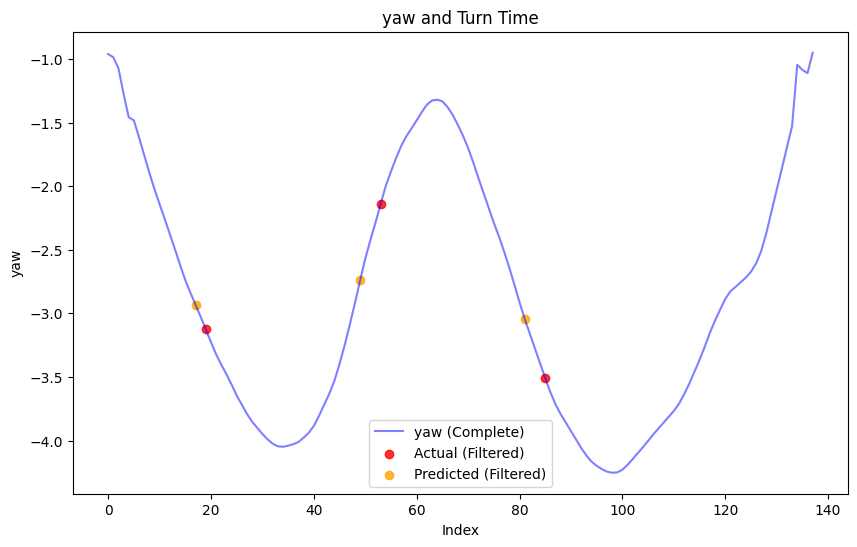

In [78]:
plot_filter_and_extract_points(df_complete=df, df_filtered=df_TP)

In [79]:
plot_filter_and_extract_points(df_complete=df, df_filtered=df_FP)

KeyError: 'Turn_Time_Actual'

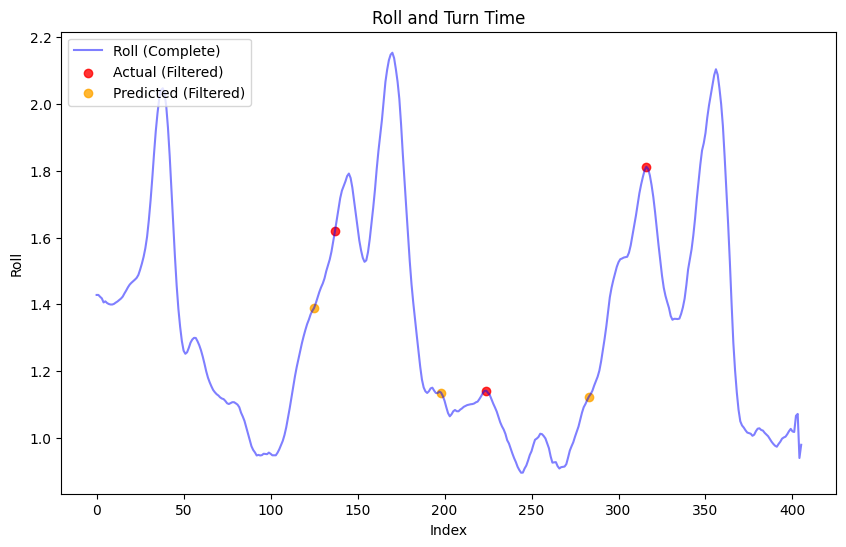

In [ ]:
plot_filter_and_extract_points(df_complete=df, df_filtered=df_FN)

In [ ]:
#Fajnie by bylo dodac filtracje mid wartosci - czyli np te w okresie 150 by sie naprawily, czyli bierzemy sobie dla min i max jak wygladaj i od tego bierzemy odchyly - ALE DLA
        # KAZDEGO TYPU OSOBNO CZYLI DLA LEFT PONIEZEJ WARTOSCI A DLA RIGHT POWYZEJ WARTOSCI
#zostawienie krancow
#

In [188]:
def align_min_max_lists_counts_order(new_filtered_mins, new_filtered_max): # Zachowujemy pierwszą i ostatnią wartość first = min(new_filtered_mins[0], new_filtered_max[0]) last = max(new_filtered_mins[-1], new_filtered_max[-1]) # Tworzymy nowe listy z zachowaniem pierwszej wartości new_mins = [first] new_max = [] # Usuwamy pierwszą i ostatnią wartość z obu list do przetwarzania mins_rest = new_filtered_mins[1:-1] max_rest = new_filtered_max[1:-1] # Tworzymy nowe listy z zachowaniem naprzemiennej kolejności wartości add_to_mins = True while mins_rest or max_rest: if add_to_mins and mins_rest: new_mins.append(mins_rest.pop(0)) elif not add_to_mins and max_rest: new_max.append(max_rest.pop(0)) add_to_mins = not add_to_mins # Dodajemy ostatnią wartość do odpowiedniej listy if len(new_mins) <= len(new_max): new_mins.append(last) else: new_max.append(last) return new_mins, new_max # Przykładowe wywołanie funkcji new_filtered_mins = [1, 8, 9, 10, 12, 50] new_filtered_max = [2, 4, 5, 11, 20, 30] result = align_min_max_lists_counts_order(new_filtered_mins, new_filtered_max) print(result) # Output: ([1, 10, 12, 50], [5, 11, 30])

([1, 8, 9, 10, 12], [4, 5, 11, 20, 50])


In [189]:
def align_min_max_lists_counts_order(new_filtered_mins, new_filtered_max): # Zachowujemy pierwszą i ostatnią wartość first = min(new_filtered_mins[0], new_filtered_max[0]) last = max(new_filtered_mins[-1], new_filtered_max[-1]) # Tworzymy nowe listy z zachowaniem pierwszej wartości new_mins = [first] new_max = [] # Usuwamy pierwszą i ostatnią wartość z obu list do przetwarzania mins_rest = new_filtered_mins[1:-1] max_rest = new_filtered_max[1:-1] # Tworzymy nowe listy z zachowaniem naprzemiennej kolejności wartości add_to_mins = True while mins_rest or max_rest: if add_to_mins and mins_rest: new_mins.append(mins_rest.pop(0)) elif not add_to_mins and max_rest: new_max.append(max_rest.pop(0)) add_to_mins = not add_to_mins # Dodajemy ostatnią wartość do odpowiedniej listy if len(new_mins) <= len(new_max): new_mins.append(last) else: new_max.append(last) return new_mins, new_max # Przykładowe wywołanie funkcji new_filtered_mins = [1, 8, 9, 10, 12, 50] new_filtered_max = [2, 4, 5, 11, 20, 30] result = align_min_max_lists_counts_order(new_filtered_mins, new_filtered_max) print(result) # Output: ([1, 10, 12, 50], [5, 11, 30])

Aligned mins: [1, 40]
Aligned maxs: [8]


In [192]:
def align_min_max_lists_counts_order(new_filtered_mins, new_filtered_max):
    # Zachowujemy pierwszą i ostatnią wartość
    first = min(new_filtered_mins[0], new_filtered_max[0])
    last = max(new_filtered_mins[-1], new_filtered_max[-1])
    
    new_mins =[]
    new_maxs = []
    
    if first in new_filtered_mins:
        new_mins[0] = first
    else:
        new_maxs[0] = first 
    if last in new_filtered_mins:
        new_mins[0] = last
    else:
        new_maxs[0] = last 
        
    #TODO
    return new_mins, new_maxs

# Przykładowe wywołanie funkcji
new_filtered_mins = [1, 8, 9, 10, 12, 50]
new_filtered_max = [2, 4, 5, 11, 20, 30]
result = align_min_max_lists_counts_order(new_filtered_mins, new_filtered_max)
print(result)  # Output: ([1, 10, 12, 50], [5, 11, 30])


([1, 8, 9, 10, 12], [4, 5, 11, 20, 50])


In [231]:
def find_max_el_between_current_next(current, next_el, searched_list):
    # Find max element between current and next element
    max_val = -1
    for i in searched_list:
        if i > current and i < next_el:
            max_val = i
    return max_val

def get_next_el(current, searched_list):
    # Get next element from list, assuming current element is in the list
    if searched_list.index(current) + 1 < len(searched_list):
        return searched_list[searched_list.index(current) + 1]
    else:
        return None  # Jeśli nie ma następnego elementu, zwróć None

def align_min_max_lists_counts_order(new_filtered_mins, new_filtered_max, counts_min, counts_max):
    # Zachowujemy pierwszą i ostatnią wartość
    first = min(new_filtered_mins[0], new_filtered_max[0])
    
    new_mins = []
    new_maxs = []
    
    # Przypisujemy pierwszą wartość do odpowiedniej listy
    if first in new_filtered_mins:
        new_mins.append(first)
        left_search = True  # Zaczynamy od new_filtered_mins
    else:
        new_maxs.append(first)
        left_search = False  # Zaczynamy od new_filtered_max
    
    current = first
    while new_filtered_mins or new_filtered_max:
        if left_search:
            # Zdobądź następny element z new_filtered_max
            next_el = get_next_el(current, new_filtered_mins)
            if next_el is None:  # Jeśli nie ma kolejnego elementu, zakończymy
                break
            current = find_max_el_between_current_next(current, next_el, new_filtered_max)
            if current != -1:  # Jeśli znaleziono element, dodajemy go
                new_maxs.append(current)
            left_search = False  # Następny krok będzie z new_filtered_mins
        else:
            # Zdobądź następny element z new_filtered_mins
            next_el = get_next_el(current, new_filtered_max)
            if next_el is None:  # Jeśli nie ma kolejnego elementu, zakończymy
                break
            current = find_max_el_between_current_next(current, next_el, new_filtered_mins)
            if current != -1:  # Jeśli znaleziono element, dodajemy go
                new_mins.append(current)
            left_search = True  # Następny krok będzie z new_filtered_max
    
    # Dodaj ostatni element, który nie został uwzględniony
    if new_filtered_mins and current != new_filtered_mins[-1]:
        new_mins.append(new_filtered_mins[-1])
    
    return new_mins, new_maxs

# Przykładowe wywołanie funkcji
new_filtered_mins = [1, 8, 9, 10, 12, 50]
new_filtered_max = [2, 4, 5, 11, 20, 30, 60, 70]
result = align_min_max_lists_counts_order(new_filtered_mins, new_filtered_max)
print(result)  # Oczekiwany wynik: ([1, 10, 12, 50], [5, 11, 30])

([1, 10, 12, 50], [5, 11, 30])


In [ ]:
new_filtered_mins = [1, 8, 9, 10, 12, 50]
new_filtered_max = [2, 4, 5, 11, 20, 30]
min_counts = [1, 10, 3, 4, 5, 6]
max_counts = [1, 6, 3, 4, 5, 6]
Oczekiwany wynik: ([1, 8, 12, 50], [4, 11, 30])

In [39]:
def find_max_el_between_current_next(current, next_el, searched_list, counts_list):
    # Find the element with the highest counts between current and next element
    max_count = -1
    max_el = None
    for i in range(len(searched_list)):
        if current < searched_list[i] < next_el:
            if counts_list[i] > max_count:
                max_count = counts_list[i]
                max_el = searched_list[i]
    return max_el

def get_next_el(current, searched_list, add_index=1):
    if add_index > 20:
        return None
    # Get next element from list, assuming current element is in the list
    if searched_list.index(current) + add_index< len(searched_list):
        return searched_list[searched_list.index(current) + add_index]
    else:
        return get_next_el(current, searched_list, add_index=add_index+1)  # Jeśli nie ma następnego elementu, zwróć None

def align_min_max_lists_counts_order(new_filtered_mins, new_filtered_max, min_counts, max_counts):
    # Zachowujemy pierwszą wartość
    first = min(new_filtered_mins[0], new_filtered_max[0])
    last = max(new_filtered_mins[-1], new_filtered_max[-1])
    
    new_mins = []
    new_maxs = []
    
    # Przypisujemy pierwszą wartość do odpowiedniej listy
    if first in new_filtered_mins:
        new_mins.append(first)
        left_search = True  # Zaczynamy od new_filtered_mins
    else:
        new_maxs.append(first)
        left_search = False  # Zaczynamy od new_filtered_max
        
    
    current = first
    while new_filtered_mins or new_filtered_max:
        if left_search:
            # Zdobądź następny element z new_filtered_max
            next_el = get_next_el(current, new_filtered_mins)
            if next_el is None:  # Jeśli nie ma kolejnego elementu, zakończymy
                break
            # Wybierz element z największym counts w przedziale
            current_t = find_max_el_between_current_next(current, next_el, new_filtered_max, max_counts)
            while current_t is None :
                next_el = get_next_el(next_el, new_filtered_mins)
                if next_el is None:
                    break
                current_t = find_max_el_between_current_next(current, next_el, new_filtered_max, min_counts)

            current = current_t
            if current != -1:  # Jeśli znaleziono element, dodajemy go
                new_maxs.append(current)
            # Usuwamy elementy z przedziału
            new_filtered_max = [x for x in new_filtered_max if x <= current or x >= next_el]
            left_search = False  # Następny krok będzie z new_filtered_mins
        else:
            # Zdobądź następny element z new_filtered_mins
            next_el = get_next_el(current, new_filtered_max)
            if next_el is None:  # Jeśli nie ma kolejnego elementu, zakończymy
                break
            # Wybierz element z największym counts w przedziale
            current_t = find_max_el_between_current_next(current, next_el, new_filtered_mins, min_counts)


            while current_t is None:
                next_el = get_next_el(next_el, new_filtered_max)
                if next_el is None:
                    break
                current_t = find_max_el_between_current_next(current, next_el, new_filtered_mins, min_counts)

            current = current_t

            if current != -1:  # Jeśli znaleziono element, dodajemy go
                new_mins.append(current)
            # Usuwamy elementy z przedziału
            new_filtered_mins = [x for x in new_filtered_mins if x <= current or x >= next_el]
            left_search = True  # Następny krok będzie z new_filtered_max
    
    # Dodaj ostatni element, który nie został uwzględniony
    if last in new_filtered_mins and last not in new_mins:
        new_mins.append(last) 
    elif last in new_filtered_max and last not in new_maxs:
        new_maxs.append(last)
    
    return new_mins, new_maxs

def add_predicted_transitions_to_df(df, predicted_mins, predicted_maxs):
    df_cp = df.copy()  # Create a copy of the DataFrame to avoid modifying the original one
    
    # Iterate over the predicted_mins indices (points where 'left' should be assigned)
    for idx in predicted_mins:
        # Access the 'time' column to get the datetime value for the corresponding index
        time_value = df_cp.index[idx]
        df_cp.loc[time_value, 'Predicted'] = 'left'
        
    # Iterate over the predicted_maxs indices (points where 'right' should be assigned)
    for idx in predicted_maxs:
        # Access the 'time' column to get the datetime value for the corresponding index
        time_value = df_cp.index[idx]
        df_cp.loc[time_value, 'Predicted'] = 'right'
    
    #fill Nan with 'right' or 'left' based on the above one. So if first is 'right' we will fill all NaN with 'right' until we find 'left'
    df_cp['Predicted'] = df_cp['Predicted'].fillna(method='ffill')
    df_cp['Behavior'] = df_cp['Behavior'].fillna(method='ffill')
    return df_cp

def get_score_for_intervals(df):
    # check when bevaviour is the same as predicted and return one score
    score = 0
    for index, row in df.iterrows():
        if row['Behavior'] == row['Predicted']:
            score += 1
    score = score / len(df)        
    return score
    
# Przykładowe wywołanie funkcji
t_new_filtered_mins = [1, 8, 10, 12, 50, 70]
t_new_filtered_max = [9, 11, 20, 30, 40]
t_min_counts = [1, 10, 3, 4, 5, 6]
t_max_counts = [1, 6, 3, 4, 26]
#new_method_mins, new_method_max = align_min_max_lists_counts_order(t_new_filtered_mins, t_new_filtered_max, t_min_counts, t_max_counts)
new_method_mins, new_method_max = align_min_max_lists_counts_order(new_filtered_mins, new_filtered_max, new_filtered_mins_counts, new_filtered_maxs_counts)
inteval_df = add_predicted_transitions_to_df(df, new_method_mins, new_method_max)
get_score_for_intervals(inteval_df)
#print(result)  # Oczekiwany wynik: ([1, 8, 12, 50], [4, 11, 30])


0.8929765886287625

In [50]:
new_method_mins, new_method_max = align_min_max_lists_counts_order(new_filtered_mins, new_filtered_max, new_filtered_mins_counts, new_filtered_maxs_counts)
inteval_df = add_predicted_transitions_to_df(df, new_method_mins, new_method_max)
# df_scores_sum, df_lenghts = get_score_for_intervals(inteval_df)
# total_score += df_scores_sum
# total_lenght += df_lenghts

In [ ]:
#plot inteval_df yaw where prediction is left with green and right with blue
import plotly.graph_objects as go

def plot_predicted_transitions(inteval_df):
    fig = go.Figure()
    #fig.add_trace(go.Scatter(x=inteval_df.index, y=inteval_df['yaw'], mode='lines', name='Yaw'))
    fig.add_trace(go.Scatter(x=inteval_df[inteval_df['Predicted'] == 'left'].index, y=inteval_df[inteval_df['Predicted'] == 'left']['yaw'], mode='markers', marker=dict(color='green'), name='Predicted left'))
    fig.add_trace(go.Scatter(x=inteval_df[inteval_df['Predicted'] == 'right'].index, y=inteval_df[inteval_df['Predicted'] == 'right']['yaw'], mode='markers', marker=dict(color='blue'), name='Predicted right'))
    fig.update_layout(
        title=dict(
            text=(
                f"Predicted turns on yaw"
            ),
            font=dict(size=30),  # Increase title font size
        ),

        xaxis_title=dict(
            text="Time",
            font=dict(size=20)  # Increase x-axis label font size
        ),
        yaxis_title=dict(
            text="Radians",
            font=dict(size=20)  # Increase y-axis label font size
        ),
        legend=dict(
            x=0.01,  # Position the legend inside the plot
            y=0.99,
            traceorder="normal",
            bgcolor="rgba(255, 255, 255, 0.8)",
            bordercolor="Black",
            borderwidth=2,
            font=dict(size=30),  # Increase legend text size
            itemsizing="constant",  # Ensure consistent marker size in legend
            itemwidth=40,  # Increase width of legend items
        ),
        width=1200,  # Set the width of the plot
        height=600,  # Set the height of the plot
    )
    fig.show(        config={
            "toImageButtonOptions": {
                "format": "png",  # one of png, svg, jpeg, webp
                "filename": "custom_image",
                "scale": 6,  # Multiply title/legend/axis/canvas sizes by this factor
            }
        })
plot_predicted_transitions(inteval_df)


In [40]:
#plot inteval_df yaw column with green line where predicted is the same as behavior with red line where it is not
import plotly.graph_objects as go
def plot_intervals(inteval_df):
    fig = go.Figure()
    fig.add_trace(go.Scatter
                    (x=inteval_df.index, y=inteval_df['yaw'], mode='lines', name='Yaw'))
    fig.add_trace(go.Scatter
                    (x=inteval_df[inteval_df['Predicted'] == inteval_df['Behavior']].index, y=inteval_df[inteval_df['Predicted'] == inteval_df['Behavior']]['yaw'], mode='markers', marker=dict(color='green'), name='Correct prediction'))
    fig.add_trace(go.Scatter
                    (x=inteval_df[inteval_df['Predicted'] != inteval_df['Behavior']].index, y=inteval_df[inteval_df['Predicted'] != inteval_df['Behavior']]['yaw'], mode='markers', marker=dict(color='red'), name='Incorrect prediction'))
    fig.show()
plot_intervals(inteval_df)



In [309]:
d = 2
a = d
d+1
a

2

In [281]:
df['time'] == 

Timestamp('2024-02-25 12:44:34.500000')

In [278]:
add_predicted_transitions_to_df(df, new_method_mins, new_method_max)

KeyError: 'time'

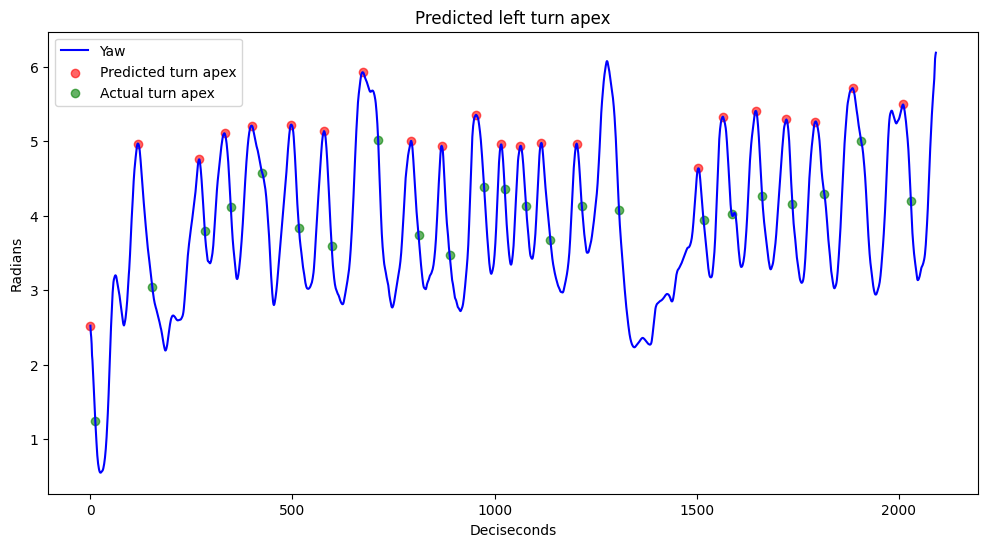

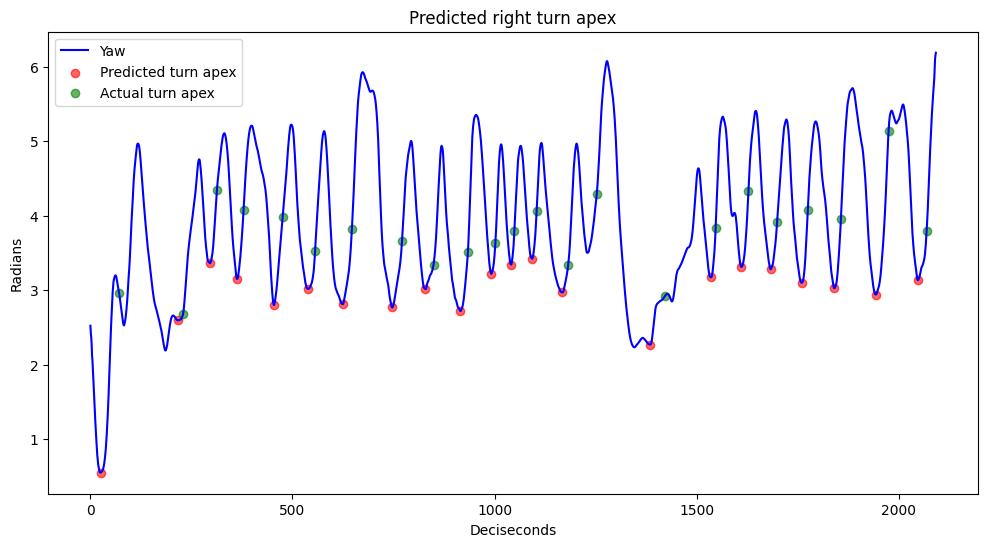

In [248]:
plot_positions(df['yaw'].values, new_method_max, "Selected min_point", get_apex_points(df, turn="right"),title= "Predicted left turn apex")
plot_positions(df['yaw'].values, new_method_mins, "Selected max_points", get_apex_points(df, turn="left"),  title= "Predicted right turn apex")

In [ ]:
# def find_max_el_between_current_next(current, next_el, searched_list, counts_list):
#     # Find the element with the highest counts between current and next element
#     max_count = -1
#     max_el = None
#     for i in range(len(searched_list)):
#         if current < searched_list[i] < next_el:
#             if counts_list[i] > max_count:
#                 max_count = counts_list[i]
#                 max_el = searched_list[i]
#     return max_el

# def get_next_el(current, searched_list, add_index=1):
#     # Get next element from list, assuming current element is in the list
#     if searched_list.index(current) + add_index< len(searched_list):
#         return searched_list[searched_list.index(current) + add_index]
#     else:
#         return get_next_el(current, searched_list, add_index=add_index+1)  # Jeśli nie ma następnego elementu, zwróć None

# def align_min_max_lists_counts_order(new_filtered_mins, new_filtered_max, min_counts, max_counts):
#     # Zachowujemy pierwszą wartość
#     first = min(new_filtered_mins[0], new_filtered_max[0])
    
#     new_mins = []
#     new_maxs = []
    
#     # Przypisujemy pierwszą wartość do odpowiedniej listy
#     if first in new_filtered_mins:
#         new_mins.append(first)
#         left_search = True  # Zaczynamy od new_filtered_mins
#     else:
#         new_maxs.append(first)
#         left_search = False  # Zaczynamy od new_filtered_max
    
#     current = first
#     while new_filtered_mins or new_filtered_max:
#         if left_search:
#             # Zdobądź następny element z new_filtered_max
#             next_el = get_next_el(current, new_filtered_mins)
#             if next_el is None:  # Jeśli nie ma kolejnego elementu, zakończymy
#                 break
#             # Wybierz element z największym counts w przedziale
#             current = find_max_el_between_current_next(current, next_el, new_filtered_max, max_counts)
#             if current != -1:  # Jeśli znaleziono element, dodajemy go
#                 new_maxs.append(current)
#             # Usuwamy elementy z przedziału
#             new_filtered_max = [x for x in new_filtered_max if x <= current or x >= next_el]
#             left_search = False  # Następny krok będzie z new_filtered_mins
#         else:
#             # Zdobądź następny element z new_filtered_mins
#             next_el = get_next_el(current, new_filtered_max)
#             if next_el is None:  # Jeśli nie ma kolejnego elementu, zakończymy
#                 break
#             # Wybierz element z największym counts w przedziale
#             current = find_max_el_between_current_next(current, next_el, new_filtered_mins, min_counts)
#             if current != -1:  # Jeśli znaleziono element, dodajemy go
#                 new_mins.append(current)
#             # Usuwamy elementy z przedziału
#             new_filtered_mins = [x for x in new_filtered_mins if x <= current or x >= next_el]
#             left_search = True  # Następny krok będzie z new_filtered_max
    
#     # Dodaj ostatni element, który nie został uwzględniony
#     if new_filtered_mins and current != new_filtered_mins[-1]:
#         new_mins.append(new_filtered_mins[-1])
    
#     return new_mins, new_maxs

# def add_predicted_transitions_to_df(df, predicted_mins, predicted_maxs):
#     df_cp = df.copy()  # Create a copy of the DataFrame to avoid modifying the original one
    
#     # Iterate over the predicted_mins indices (points where 'left' should be assigned)
#     for idx in predicted_mins:
#         # Access the 'time' column to get the datetime value for the corresponding index
#         time_value = df_cp.index[idx]
#         df_cp.loc[time_value, 'Predicted'] = 'left'
        
#     # Iterate over the predicted_maxs indices (points where 'right' should be assigned)
#     for idx in predicted_maxs:
#         # Access the 'time' column to get the datetime value for the corresponding index
#         time_value = df_cp.index[idx]
#         df_cp.loc[time_value, 'Predicted'] = 'right'
    
#     #fill Nan with 'right' or 'left' based on the above one. So if first is 'right' we will fill all NaN with 'right' until we find 'left'
#     df_cp['Predicted'] = df_cp['Predicted'].fillna(method='ffill')
#     df_cp['Behavior'] = df_cp['Behavior'].fillna(method='ffill')
#     return df_cp

# def get_score_for_intervals(df):
#     # check when bevaviour is the same as predicted and return one score
#     score = 0
#     for index, row in df.iterrows():
#         if row['Behavior'] == row['Predicted']:
#             score += 1
#     score = score / len(df)        
#     return score
    
# # Przykładowe wywołanie funkcji
# t_new_filtered_mins = [1, 8, 10, 12, 50, 70]
# t_new_filtered_max = [9, 11, 20, 30, 40]
# t_min_counts = [1, 10, 3, 4, 5, 6]
# t_max_counts = [1, 6, 3, 4, 26]
# new_method_mins, new_method_max = align_min_max_lists_counts_order(t_new_filtered_mins, t_new_filtered_max, t_min_counts, t_max_counts)
# #new_method_mins, new_method_max = align_min_max_lists_counts_order(new_filtered_mins, new_filtered_max, new_filtered_mins_counts, new_filtered_maxs_counts)
# inteval_df = add_predicted_transitions_to_df(df, new_method_mins, new_method_max)
# get_score_for_intervals(inteval_df)
# #print(result)  # Oczekiwany wynik: ([1, 8, 12, 50], [4, 11, 30])
